<a href="https://colab.research.google.com/github/Zyuuu-G/Quantum_code/blob/main/Quantum_hw_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import PathPatch

##Quantum hw 3
####Ziyu Gao
####2/09/2023

In [ ]:
from sympy import *

t, c1, c2, psi1, psi2, omg1, omg2 = symbols('t c1 c2 psi1 psi2 omg1 omg2')  # omg (omega) = E/hbar 

psi = c1*psi1*exp(-1j*omg1*t)+ c2*psi2*exp(-1j*omg2*t)

psi_sq = conjugate(psi)*psi
print('psi = ',psi,'\n\npsi_squred = ',psi_sq)


psi =  c1*psi1*exp(-1.0*I*omg1*t) + c2*psi2*exp(-1.0*I*omg2*t) 

psi_squred =  (c1*psi1*exp(-1.0*I*omg1*t) + c2*psi2*exp(-1.0*I*omg2*t))*(exp(1.0*I*conjugate(omg1)*conjugate(t))*conjugate(c1)*conjugate(psi1) + exp(1.0*I*conjugate(omg2)*conjugate(t))*conjugate(c2)*conjugate(psi2))


In [ ]:
init_printing()
E_1, E_2, hbar = symbols ('E_1 E_2 hbar')
(c1*psi1*exp(-1*I*E_1/hbar*t) + c2*psi2*exp(-1*I*E_2/hbar*t))*(exp(1*I*conjugate(omg1)*conjugate(t))*conjugate(c1)*conjugate(psi1) + exp(1*I*conjugate(omg2)*conjugate(t))*conjugate(c2)*conjugate(psi2))
# well, ignore this. 

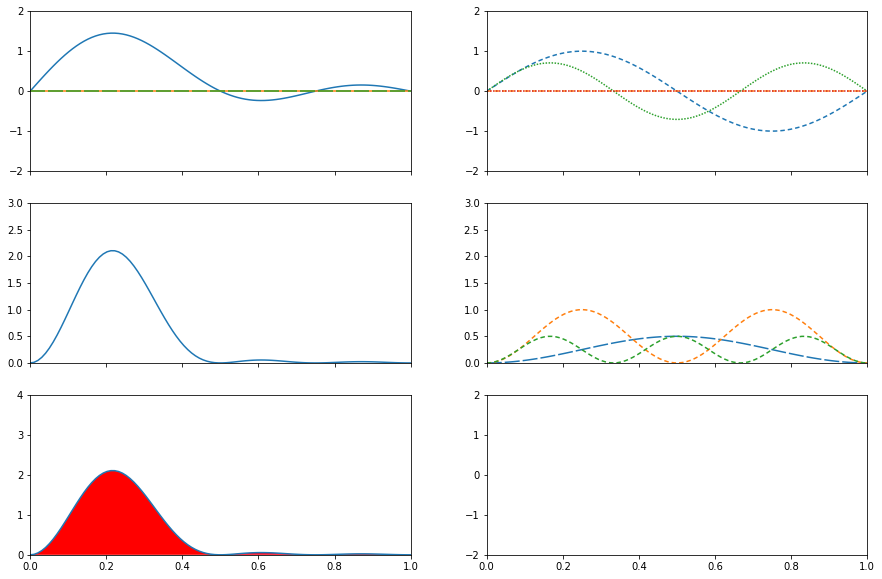

In [ ]:
# problem 1.21

from matplotlib import rc       # these lines needed to run it on Colab
rc('animation', html='jshtml')  # these lines needed to run it on Colab
plt.rcParams['figure.figsize']=15,10
cmap = plt.get_cmap('hsv')

fig, axes = plt.subplots(3,2,sharex=True)
axes[0,0].set_ylim(-2,2)
axes[1,0].set_ylim(0,3)
axes[2,0].set_ylim(0,4)
axes[0,1].set_ylim(-2,2)
axes[1,1].set_ylim(0,3)
axes[2,1].set_ylim(-2,2)

a=1
x_min=0
x_max=a
x = np.linspace(x_min,x_max, 100)

psi1=1/np.sqrt(2/a)*np.sin(1*np.pi*x/a)
psi2=1*np.sin(2*np.pi*x/a)
psi3=1/np.sqrt(2/a)*np.sin(3*np.pi*x/a)

psi = 1/np.sqrt(2)*(psi1+psi2+psi3)

# plot wave functions 
line1, = axes[0,0].plot(x, np.real(psi))
line2, = axes[0,0].plot(x, np.imag(psi))
line3, = axes[0,0].plot(x,np.imag(psi1), dashes=[10, 2])
line4, = axes[0,1].plot(x,np.real(psi2), dashes=[3, 2])
line5, = axes[0,1].plot(x,np.imag(psi2), dashes=[3, 2])
line6, = axes[0,1].plot(x,np.real(psi3), dashes=[1, 1])
line7, = axes[0,1].plot(x,np.imag(psi3), dashes=[1, 1])

prob = np.real_if_close(np.conjugate(psi)*psi)
prob1 = np.real_if_close(np.conjugate(psi1)*psi1)
prob2 = np.real_if_close(np.conjugate(psi2)*psi2)
prob3 = np.real_if_close(np.conjugate(psi3)*psi3)

phase = np.angle(psi)

# plot probability
line8, = axes[1,0].plot(x,prob)
line9, = axes[1,1].plot(x,prob1,dashes=[10, 2])
line10, = axes[1,1].plot(x,prob2,dashes=[3, 2])
line11, = axes[1,1].plot(x,prob3,dashes=[3, 2])

# phase plot
time_step = 0.02

line12, = axes[2,0].plot(x,prob)

poly = axes[2,0].fill_between(x, 0, prob, color='none')
img = axes[2,0].imshow(phase.reshape(1, -1), extent=[x[0], x[-1], 0, prob.max()], cmap=cmap, aspect='auto')
clip_poly = PathPatch(poly.get_paths()[0], transform=axes[2,0].transData)
img.set_clip_path(clip_poly)


In [ ]:
plt.rcParams['figure.figsize']=10,5

In [ ]:
# animation
import matplotlib.animation as animation

def animate(i):
    time_step = 0.02
    omega1 = 1
    omega2 = 4
    omega3 = 8
    wiggle1 = np.exp(-1.0j*omega1*i*time_step)
    wiggle2 = np.exp(-1.0j*omega2*i*time_step)
    wiggle3 = np.exp(-1.0j*omega3*i*time_step)


    psi = 1/np.sqrt(2)*(psi1*wiggle1 + psi2*wiggle2 + psi3*wiggle3)
    prob = np.real_if_close(np.conjugate(psi)*psi)
    phase = np.angle(psi)
    
    line1.set_ydata(np.real(psi))  # update the data.
    line2.set_ydata(np.imag(psi))  # update the data.
    line3.set_ydata(np.real(psi1*wiggle1))
    line4.set_ydata(np.imag(psi1*wiggle1))
    line5.set_ydata(np.real(psi2*wiggle2))
    line6.set_ydata(np.imag(psi2*wiggle2))
    
    line7.set_ydata(prob)
    line8.set_ydata(np.real_if_close(np.conjugate(psi1*wiggle1)*psi1*wiggle1))
    line9.set_ydata(np.real_if_close(np.conjugate(psi2*wiggle2)*psi2*wiggle2))
    
    line10.set_ydata(prob)
    poly = ax3.fill_between(x, 0, prob, color='none')
    img = ax3.imshow(phase.reshape(1, -1), extent=[x[0], x[-1], 0, prob.max()], cmap=cmap, aspect='auto')
    clip_poly = PathPatch(poly.get_paths()[0], transform=ax3.transData)
    img.set_clip_path(clip_poly)
    
    return line1, line2, line3, line4, line5, line6, line7, line8, line9, line10, img

#ani = animation.FuncAnimation(fig, animate, interval=40, blit=True)

#writer = animation.FFMpegWriter(
#fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie.mp4", writer=writer)

#plt.show()

NFRAMES = 300
line_ani = animation.FuncAnimation(fig,animate,blit=True,frames=NFRAMES,interval=1)
line_ani  

Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py", line 196, in process
    func(*args, **kwargs)
  File "/usr/local/lib/python3.8/dist-packages/matplotlib/animation.py", line 951, in _start
    self._init_draw()
  File "/usr/local/lib/python3.8/dist-packages/matplotlib/animation.py", line 1743, in _init_draw
    self._draw_frame(next(self.new_frame_seq()))
  File "/usr/local/lib/python3.8/dist-packages/matplotlib/animation.py", line 1766, in _draw_frame
    self._drawn_artists = self._func(framedata, *self._args)
  File "<ipython-input-11-c5370a4200dc>", line 30, in animate
    poly = ax3.fill_between(x, 0, prob, color='none')
NameError: name 'ax3' is not defined


NameError: ignored

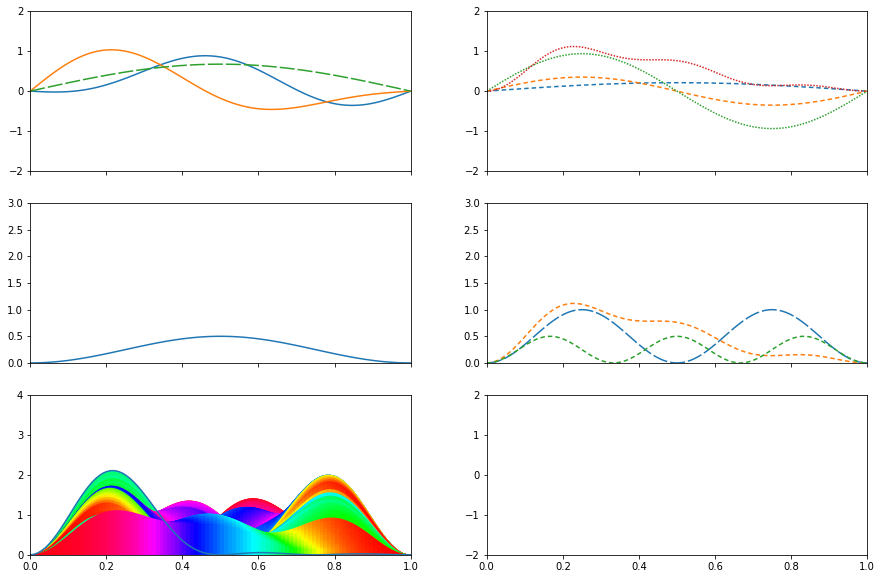

In [ ]:
# problem 1.21

from matplotlib import rc       # these lines needed to run it on Colab
rc('animation', html='jshtml')  # these lines needed to run it on Colab
plt.rcParams['figure.figsize']=15,10
cmap = plt.get_cmap('hsv')

fig, axes = plt.subplots(3,2,sharex=True)
axes[0,0].set_ylim(-2,2)
axes[1,0].set_ylim(0,3)
axes[2,0].set_ylim(0,4)
axes[0,1].set_ylim(-2,2)
axes[1,1].set_ylim(0,3)
axes[2,1].set_ylim(-2,2)

a=1
x_min=0
x_max=a
x = np.linspace(x_min,x_max, 100)

psi1=1/np.sqrt(2/a)*np.sin(1*np.pi*x/a)
psi2=1*np.sin(2*np.pi*x/a)
psi3=1/np.sqrt(2/a)*np.sin(3*np.pi*x/a)

psi = 1/np.sqrt(2)*(psi1+psi2+psi3)

# plot wave functions 
line1, = axes[0,0].plot(x, np.real(psi))
line2, = axes[0,0].plot(x, np.imag(psi))
line3, = axes[0,0].plot(x,np.imag(psi1), dashes=[10, 2])
line4, = axes[0,1].plot(x,np.real(psi2), dashes=[3, 2])
line5, = axes[0,1].plot(x,np.imag(psi2), dashes=[3, 2])
line6, = axes[0,1].plot(x,np.real(psi3), dashes=[1, 1])
line7, = axes[0,1].plot(x,np.imag(psi3), dashes=[1, 1])

prob = np.real_if_close(np.conjugate(psi)*psi)
prob1 = np.real_if_close(np.conjugate(psi1)*psi1)
prob2 = np.real_if_close(np.conjugate(psi2)*psi2)
prob3 = np.real_if_close(np.conjugate(psi3)*psi3)

phase = np.angle(psi)

# plot probability
line8, = axes[1,0].plot(x,prob)
line9, = axes[1,1].plot(x,prob1,dashes=[10, 2])
line10, = axes[1,1].plot(x,prob2,dashes=[3, 2])
line11, = axes[1,1].plot(x,prob3,dashes=[3, 2])

# phase plot
time_step = 0.02

line12, = axes[2,0].plot(x,prob)

poly = axes[2,0].fill_between(x, 0, prob, color='none')
img = axes[2,0].imshow(phase.reshape(1, -1), extent=[x[0], x[-1], 0, prob.max()], cmap=cmap, aspect='auto')
clip_poly = PathPatch(poly.get_paths()[0], transform=axes[2,0].transData)
img.set_clip_path(clip_poly)

# animation
import matplotlib.animation as animation

def animate(i):
    time_step = 0.02
    omega1 = 1
    omega2 = 4
    omega3 = 8
    wiggle1 = np.exp(-1.0j*omega1*i*time_step)
    wiggle2 = np.exp(-1.0j*omega2*i*time_step)
    wiggle3 = np.exp(-1.0j*omega3*i*time_step)


    psi = 1/np.sqrt(2)*(psi1*wiggle1 + psi2*wiggle2 + psi3*wiggle3)
    prob = np.real_if_close(np.conjugate(psi)*psi)
    phase = np.angle(psi)
    
    line1.set_ydata(np.real(psi))  # update the data.
    line2.set_ydata(np.imag(psi))  # update the data.
    line3.set_ydata(np.real(psi1*wiggle1))
    line4.set_ydata(np.imag(psi1*wiggle1))
    line5.set_ydata(np.real(psi2*wiggle2))
    line6.set_ydata(np.imag(psi2*wiggle2))
    
    line7.set_ydata(prob)
    line8.set_ydata(np.real_if_close(np.conjugate(psi1*wiggle1)*psi1*wiggle1))
    line9.set_ydata(np.real_if_close(np.conjugate(psi2*wiggle2)*psi2*wiggle2))
    
    line10.set_ydata(prob)
    poly = axes[2,0].fill_between(x, 0, prob, color='none')
    img = axes[2,0].imshow(phase.reshape(1, -1), extent=[x[0], x[-1], 0, prob.max()], cmap=cmap, aspect='auto')
    clip_poly = PathPatch(poly.get_paths()[0], transform=axes[2,0].transData)
    img.set_clip_path(clip_poly)
    
    return line1, line2, line3, line4, line5, line6, line7, line8, line9, line10, img

#ani = animation.FuncAnimation(fig, animate, interval=40, blit=True)

#writer = animation.FFMpegWriter(
#fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie.mp4", writer=writer)

#plt.show()

NFRAMES = 300
line_ani = animation.FuncAnimation(fig,animate,blit=True,frames=NFRAMES,interval=1)
line_ani  